In [1]:
! cd /home/bay001/projects/codebase/bfx/;python setup.py build && python setup.py install

/home/bay001/anaconda/lib/python2.7/distutils/dist.py:267: UserWarning: Unknown distribution option: 'include_package_data'
  warnings.warn(msg)
running build
running build_py
copying pyscripts/rnaseq/rmats_inclevel_analysis.py -> build/lib/rnaseq
/home/bay001/anaconda/lib/python2.7/distutils/dist.py:267: UserWarning: Unknown distribution option: 'include_package_data'
  warnings.warn(msg)
running install
running build
running build_py
running install_lib
copying build/lib/rnaseq/rmats_inclevel_analysis.py -> /home/bay001/anaconda/lib/python2.7/site-packages/rnaseq
byte-compiling /home/bay001/anaconda/lib/python2.7/site-packages/rnaseq/rmats_inclevel_analysis.py to rmats_inclevel_analysis.pyc
running install_egg_info
Removing /home/bay001/anaconda/lib/python2.7/site-packages/bfx-0.0.0-py2.7.egg-info
Writing /home/bay001/anaconda/lib/python2.7/site-packages/bfx-0.0.0-py2.7.egg-info


In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from rnaseq import rmats_inclevel_analysis as rmats
import pandas as pd
import numpy as np
import os
import glob
from tqdm import tnrange, tqdm_notebook

pd.set_option('display.max_columns', 500)


In [2]:
wd = '/projects/ps-yeolab3/bay001/maps/current_normed_annotations/se/'

## make merged incleveldifference matrix
- merges junction regions and get average incleveldifference for each RBP
- performs outer join on junction regions
- returns full matrix of RBPs

226/|/100%|| 226/226 [00:25<00:00, 14.26it/s]

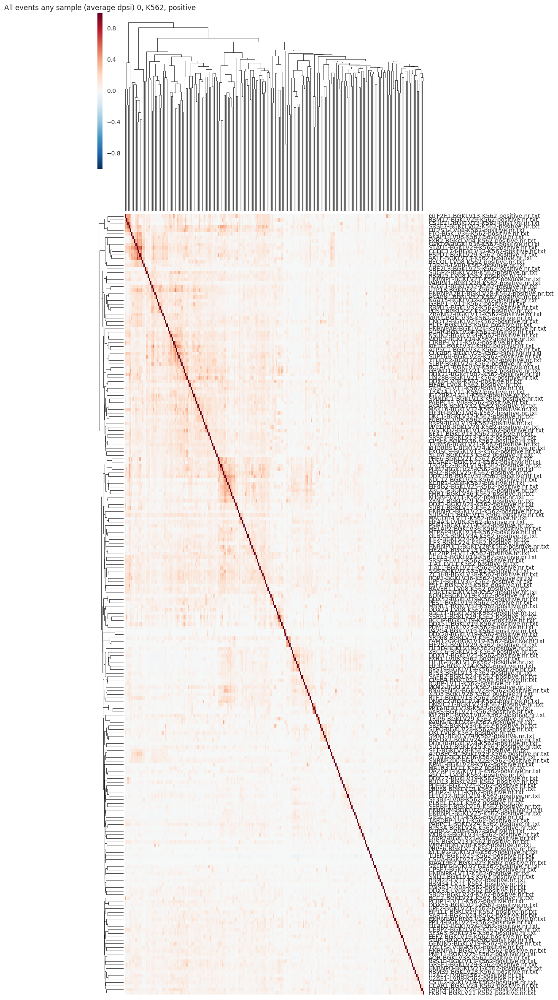

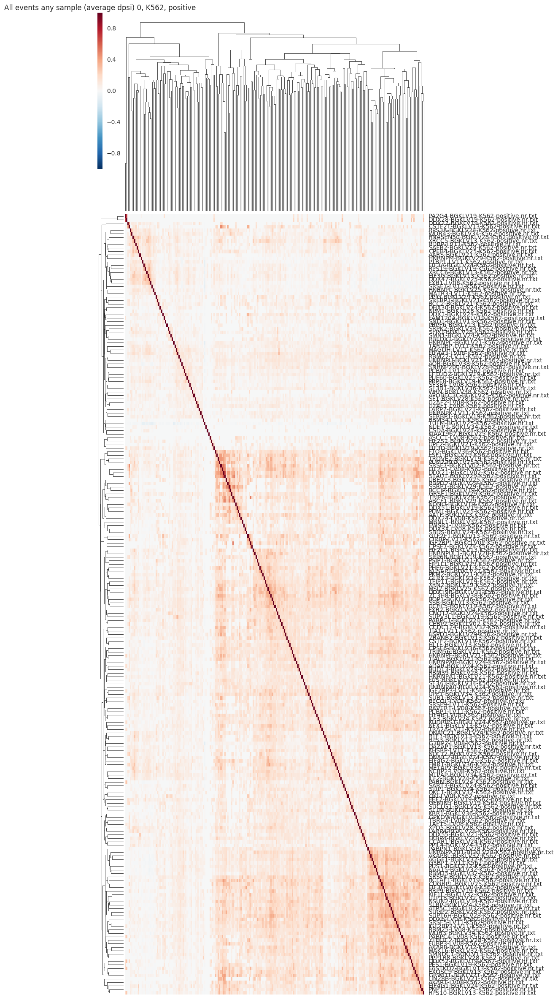

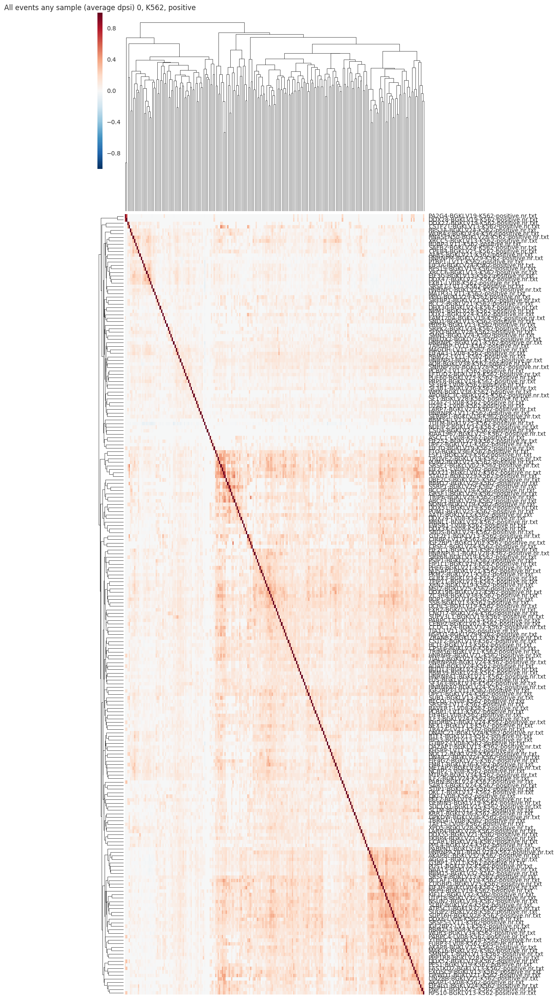

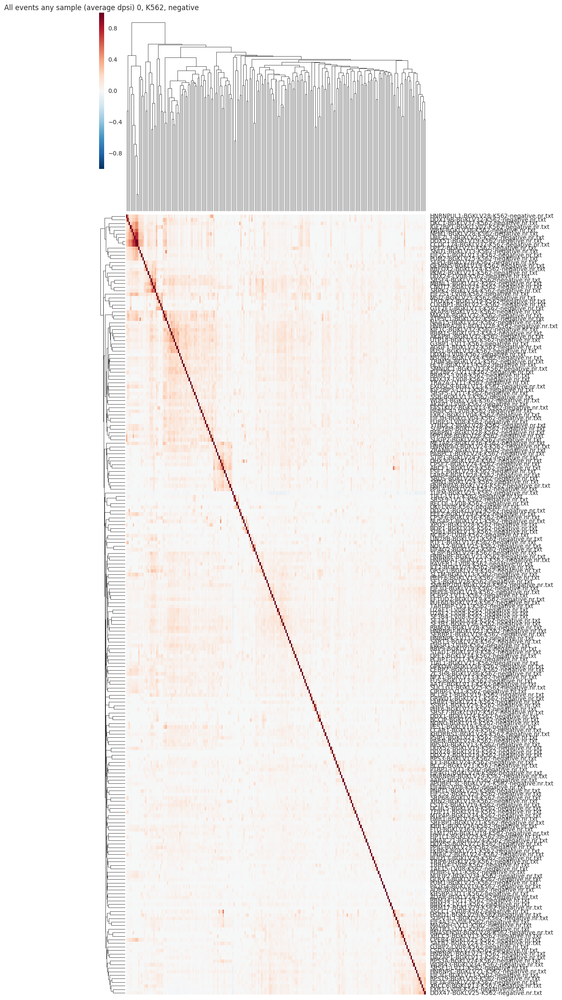

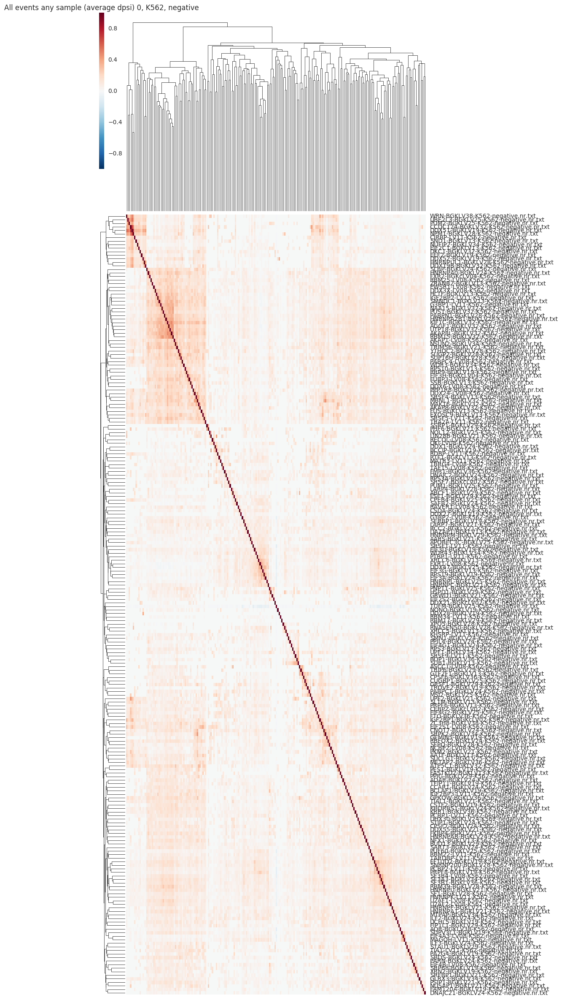

...

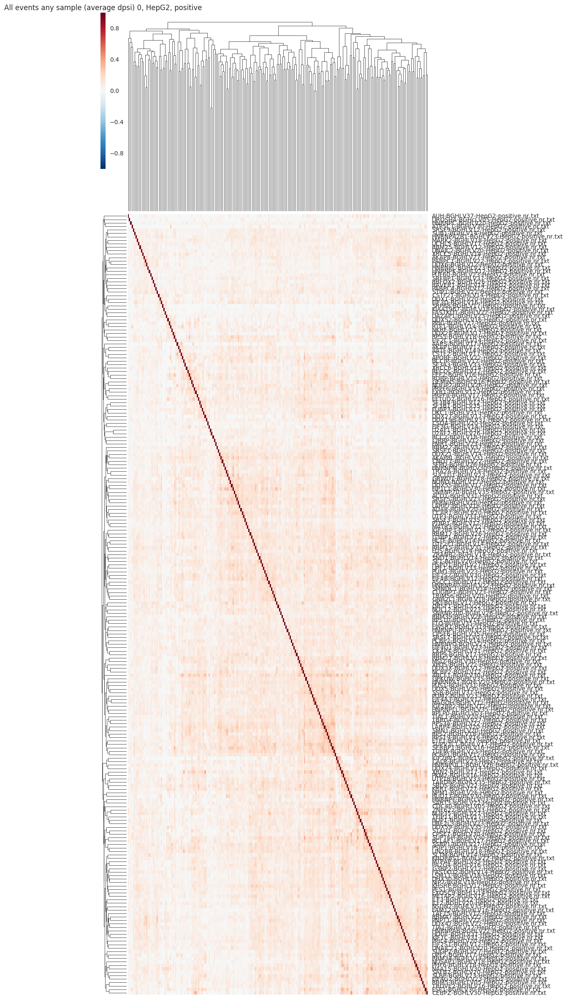

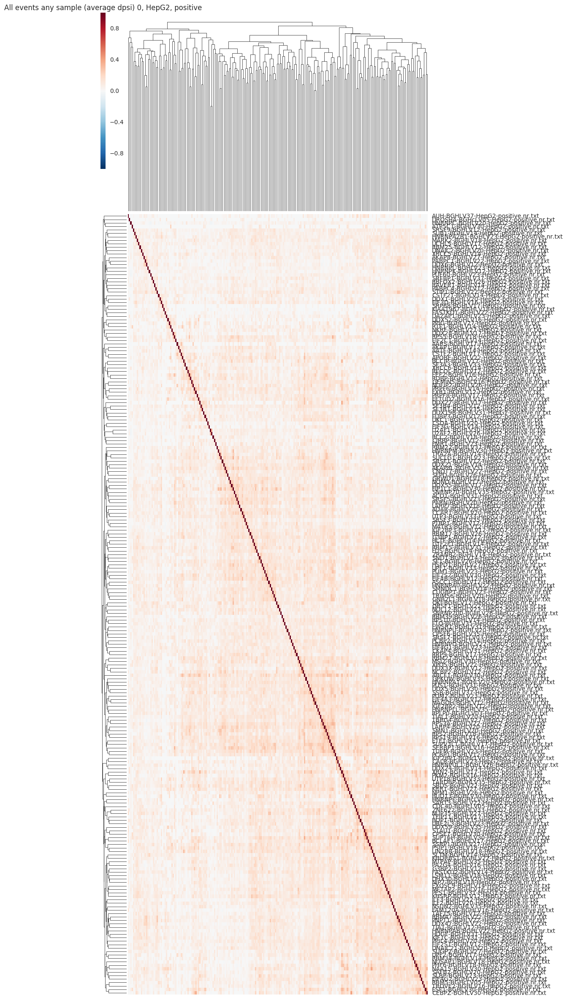

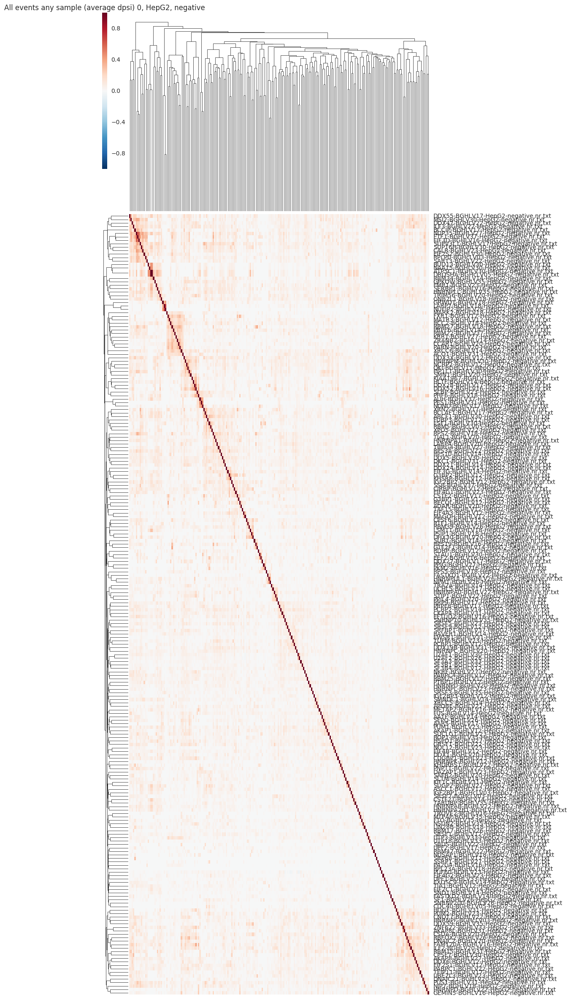

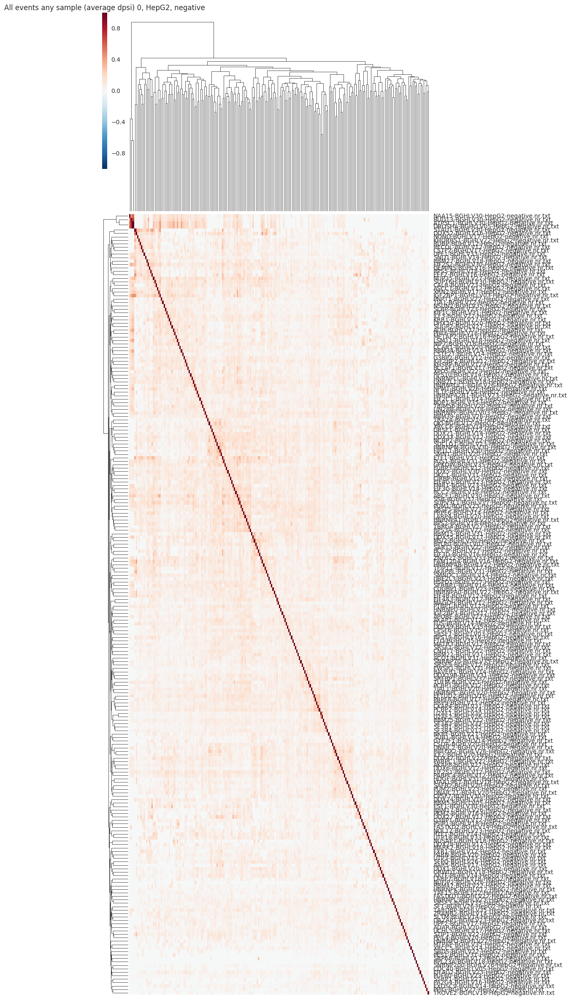

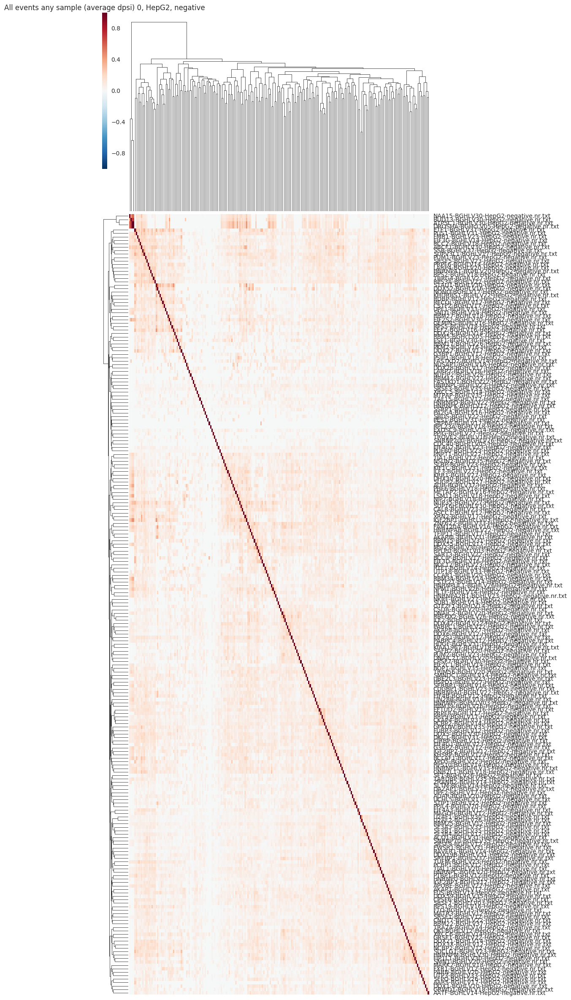

In [26]:

min_events = 0

for cell in ['K562','HepG2']:
    for condition in ['positive','negative']:
        all_files = glob.glob(os.path.join(wd,'*{}-SE.MATS.JunctionCountOnly.{}.nr.txt'.format(cell, condition)))
        merged = pd.DataFrame()
        progress = tnrange(len(all_files))
        for f in all_files:
            df = pd.read_table(f)
            if df.shape[0] >= min_events:
                name = os.path.basename(f).replace('SE.MATS.JunctionCountOnly.','')
                df['junction'] = rmats.get_junction_region(df)
                dx = rmats.get_avg_dpsi_for_all_junctions(df)
                dx.columns = [name]
                merged = pd.merge(merged, dx, how='outer', left_index=True, right_index=True)
            progress.update(1)
        for method in ['pearson','spearman','kendall']:
            g = sns.clustermap(merged.fillna(0).corr(method=method), xticklabels=False, figsize=(10,30))
            x = plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0)  # For y axis
            plt.title('All events any sample (average dpsi) {}, {}, {}'.format(min_events, cell, condition, method))
            plt.savefig(
                '/home/bay001/projects/encode/analysis/dpsi_distribution_figures/nonredundant/{}.{}.correlations.{}.png'.format(
                    cell, condition, method,
                )
            )
            plt.savefig(
                '/home/bay001/projects/encode/analysis/dpsi_distribution_figures/nonredundant/{}.{}.correlations.{}.svg'.format(
                    cell, condition, method,
                )
            )
        merged.to_csv(
            '/home/bay001/projects/encode/analysis/dpsi_distribution_figures/nonredundant/{}.{}.avg_dpsi.txt'.format(
                cell, condition
            ),
            sep='\t'
        )

# plot correlation among RBPs (NaNs are zero)

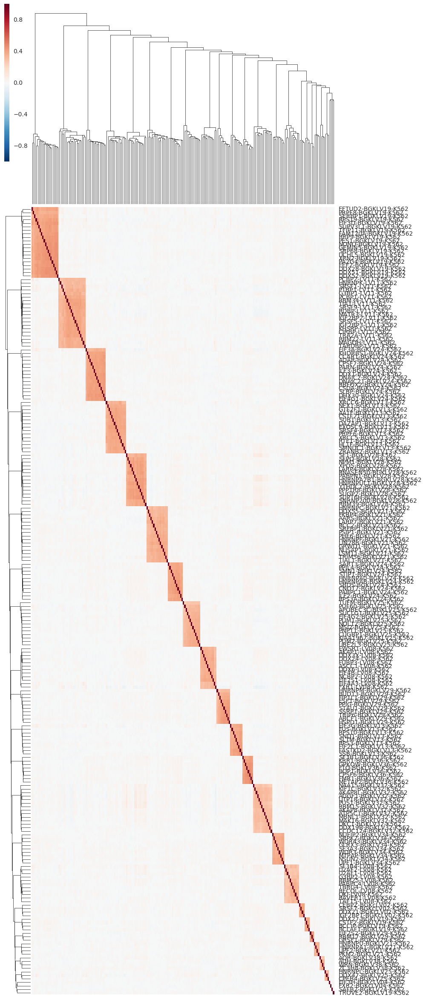

In [15]:
g = sns.clustermap(merged.fillna(0).corr(method='pearson'), xticklabels=False, figsize=(10,30))
x = plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0)  # For y axis

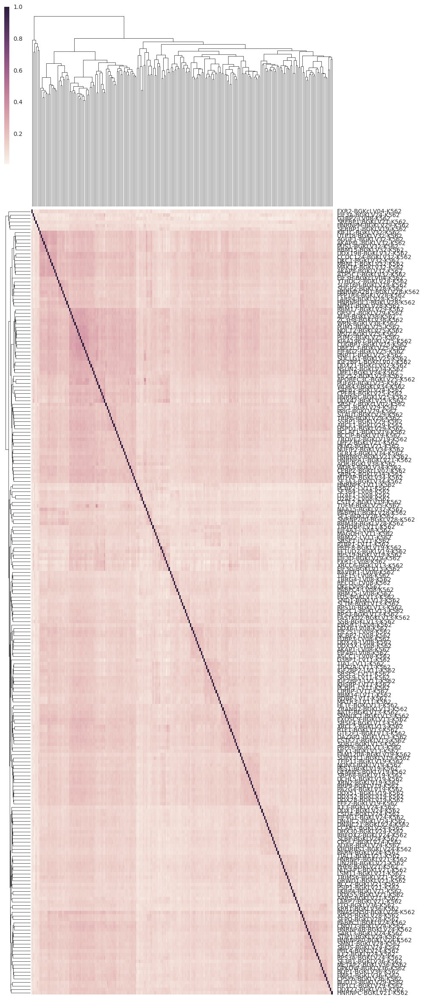

In [18]:
g = sns.clustermap(merged.fillna(0).corr(method='pearson'), xticklabels=False, figsize=(10,30))
x = plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0)  # For y axis

In [11]:
merged.isnull().sum(axis=1)

junction
chr10:100189399-100190327:-    115
chr10:100190427-100193696:-    118
chr10:100190427-100193739:-    119
chr10:100193848-100195391:-    118
chr10:101419721-101421202:+    119
chr10:101915991-101923760:-    118
chr10:101950725-101953054:-    110
chr10:101960537-101964262:-    118
chr10:102045970-102046361:-    118
chr10:102257964-102258916:-    116
chr10:103343438-103344634:-    119
chr10:103542354-103543029:-    118
chr10:103553755-103557736:-    106
chr10:103555237-103557736:-    119
chr10:103871293-103879842:-    119
chr10:104113411-104117795:+    119
chr10:104211312-104215093:+    119
chr10:104474438-104486368:+    119
chr10:104486914-104488187:+    119
chr10:104859776-104860801:-    113
chr10:104866463-104899162:-    118
chr10:105152223-105156054:-    119
chr10:105152223-105156165:-    112
chr10:105158285-105160153:+    116
chr10:105203090-105203671:+    116
chr10:105657477-105658634:-    119
chr10:105761330-105765318:+    116
chr10:105768114-105777917:+    118
chr10:10893

In [12]:
merged.shape

(7695, 120)

In [22]:
for cell in ['K562']:
    for condition in ['positive']:
        all_files = glob.glob(os.path.join(wd,'*{}-SE.MATS.JunctionCountOnly.{}.nr.txt'.format(cell, condition)))
        merged = pd.DataFrame()
        progress = tnrange(len(all_files))
        for f in all_files:
            df = pd.read_table(f)
            if df.shape[0] >= min_events:
                name = os.path.basename(f).replace('-SE.MATS.JunctionCountOnly.txt','')
                df['junction'] = rmats.get_junction_region(df)
                dx = rmats.get_avg_dpsi_for_all_junctions(df)
                dx.columns = [name]
                merged = pd.merge(merged, dx, how='outer', left_index=True, right_index=True)
            progress.update(1)

In [25]:
merged

,TIA1-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SSB-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,HNRNPF-BGKLV21-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,HNRNPA0-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,RAVER1-LV08-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX51-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PABPC1-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PCBP2-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SRP68-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SMNDC1-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,AKAP8-BGKLV32-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SF1-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,ADAR-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,HNRNPA2B1-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,EIF3G-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,UPF2-BGKLV21-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,RTF1-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PNPT1-BGKLV25-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SRSF5-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,NCBP2-LV08-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PABPN1-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX27-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DAZAP1-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,EWSR1-LV08-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,AKAP8L-BGKLV32-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DKC1-BGKLV32-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX52-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,UCHL5-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,YTHDC2-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX47-BGKLV25-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,BUD13-BGKLV29-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,MAK16-BGKLV32-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,RBM39-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,BOP1-BGKLV36-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,NONO-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,KRR1-BGKLV36-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,CUGBP1-BGKLV25-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,FXR1-LV08-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX21-BGKcLV02-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PCBP1-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,NUFIP2-BGKLV34-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,KHSRP-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,HNRNPK-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,HNRNPC-BGKLV21-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,RBM22-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,NFX1-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,EIF3D-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,CSDA-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,RBM34-LV11-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,KIF1C-BGKLV32-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PHF6-BGKLV21-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,HNRNPL-BGKLV25-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX1-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DHX30-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,IGF2BP1-BGKcLV02-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,TRIP6-BGKLV29-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,NSUN2-BGKLV34-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SSRP1-BGKLV29-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,DDX55-BGKLV21-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PARN-BGKLV24-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,RNASEN50-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,SRSF7-BGKcLV02-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,CPSF6-BGKLV36-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PES1-BGKLV19-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,PPP1R8-BGKLV28-K562-SE.MATS.JunctionCountOnly.positive.nr.txt,EIF2C1-BGKLV13-K562-SE.MATS.JunctionCountOnly.positive.nr.txt